# choropleth_mapbox for Japan

## Import

In [1]:
import pandas as pd
#pd.set_option('display.max_colwidth', None)
#pd.set_option('display.max_columns', None)

## Create Japan map shape

Original Japan map shape: https://www.esrij.com/products/japan-shp/

reference: https://irukanobox.blogspot.com/2020/01/python.html

### read shape

In [2]:
import geopandas as gpd

jpn = gpd.read_file('japan_ver83/japan_ver83.shp')
jpn.head()

,JCODE,KEN,SICHO,GUN,SEIREI,SIKUCHOSON,CITY_ENG,P_NUM,H_NUM,geometry
0,01101,北海道,石狩振興局,None,札幌市,中央区,"Sapporo-shi, Chuo-ku",238198.0,144196.0,"POLYGON ((141.34233 43.06682, 141.35520 43.068..."
1,01102,北海道,石狩振興局,None,札幌市,北区,"Sapporo-shi, Kita-ku",286186.0,153109.0,"POLYGON ((141.40839 43.18395, 141.40427 43.182..."
2,01103,北海道,石狩振興局,None,札幌市,東区,"Sapporo-shi, Higashi-ku",261922.0,143130.0,"POLYGON ((141.44698 43.15513, 141.44860 43.153..."
3,01104,北海道,石狩振興局,None,札幌市,白石区,"Sapporo-shi, Shiroishi-ku",213211.0,123314.0,"POLYGON ((141.46569 43.10000, 141.46812 43.097..."
4,01105,北海道,石狩振興局,None,札幌市,豊平区,"Sapporo-shi, Toyohira-ku",223562.0,128353.0,"POLYGON ((141.38479 43.04660, 141.38558 43.047..."


### dissolve by Prefecture

In [3]:
jpn_pref = jpn[['KEN', 'P_NUM', 'H_NUM', 'geometry']].dissolve(by='KEN', aggfunc='sum', as_index=False)

# コロプレス図を作成するときにgeometryとの対応をとるためのID
jpn_pref['ID'] = jpn_pref.index.values

jpn_pref.head()

,KEN,geometry,P_NUM,H_NUM,ID
0,三重県,"MULTIPOLYGON (((136.02423 33.73689, 136.02432 ...",1813859.0,802803.0,0
1,京都府,"MULTIPOLYGON (((135.90539 34.73686, 135.90319 ...",2545899.0,1227295.0,1
2,佐賀県,"MULTIPOLYGON (((130.22124 32.95403, 130.22046 ...",823810.0,336547.0,2
3,兵庫県,"MULTIPOLYGON (((134.74400 34.19128, 134.74388 ...",5549568.0,2558797.0,3
4,北海道,"MULTIPOLYGON (((143.24550 41.93695, 143.24644 ...",5267762.0,2790286.0,4


### save as GeoJSON

In [4]:
jpn_pref.to_file('jpnmap.geojson', driver='GeoJSON')

## Japan shape

reference: https://irukanobox.blogspot.com/2020/02/pythonplotly.html

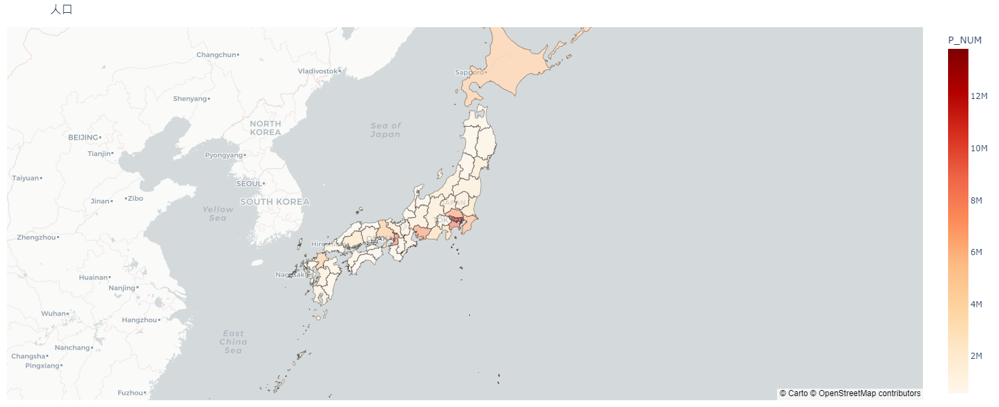

In [5]:
import json
import geopandas as gpd
import plotly.express as px
 
# コロプレス図の中心
CENTER = {'lat': 36, 'lon': 140}
 
#jpn_pref = gpd.read_file('jpnmap.geojson')
 
# GeoJSON形式で保存したときにGeoDataFrameのindexが保存されず0からのindexがふられるのでindexを再設定する
# 今回はたまたまもとのindexが0からはじまる数字なので再設定しなくても動作する
#jpn.set_index('ID', drop=False, inplace=True)
  
#print(jpn.info())
#display(jpn.head())
 
# color: 表示対象の項目
# locations: GeoJSONのIDに対応する項目
# geojson: GeoJSONをdictに変換したもの。このデータではID(0-46)がふられている
fig = px.choropleth_mapbox(
    jpn_pref, 
    geojson=json.loads(jpn_pref['geometry'].to_json()), 
    locations='ID', 
    color='P_NUM',
    title = '人口',
    hover_name = 'KEN',
    color_continuous_scale="OrRd", 
    mapbox_style='carto-positron',
    zoom=4, 
    center=CENTER,
    opacity=0.5,
    height=600,
    #labels={'DENSITY': '人口密度'}
)
fig.update_layout(margin={'r':10,'t':40,'l':10,'b':10,'pad':5})
fig.show()